# Import the necessary libraries 

In [1]:
import os
import cv2
import numpy as np
from PIL import Image, ImageEnhance, ImageOps, ImageFilter
from skimage import exposure, filters
from sklearn.metrics import mean_squared_error
from skimage.metrics import peak_signal_noise_ratio
from skimage.metrics import structural_similarity 
import matplotlib.pyplot as plt
from skimage import img_as_float
from skimage.filters import median
from skimage.filters import unsharp_mask

In [2]:
!pip install --upgrade scipy

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [3]:
# Define input and output folders
input_dir = "/content/Input Image"
output_dir = "/content/Output Image"

In [4]:
# Create output directory if it doesn't exist
os.makedirs(output_dir, exist_ok=True)

In [5]:
# Load the image
filename = os.listdir(input_dir)[0]  # Get the first image in the input folder
img = Image.open(os.path.join(input_dir, filename))

# • **Histogram** **processing** 

      – histogram equalization  
      – contrast stretching

```
# This is formatted as code
```



In [6]:
# Define lists to store the evaluation metrics for each image
mse_values = []
psnr_values = []
ssim_values = []

<ipython-input-7-077bdb705411>:51: FutureWarning: `multichannel` is a deprecated argument name for `structural_similarity`. It will be removed in version 1.0. Please use `channel_axis` instead.
  ssim_eq = structural_similarity(orig_img, eq_img, multichannel=True)


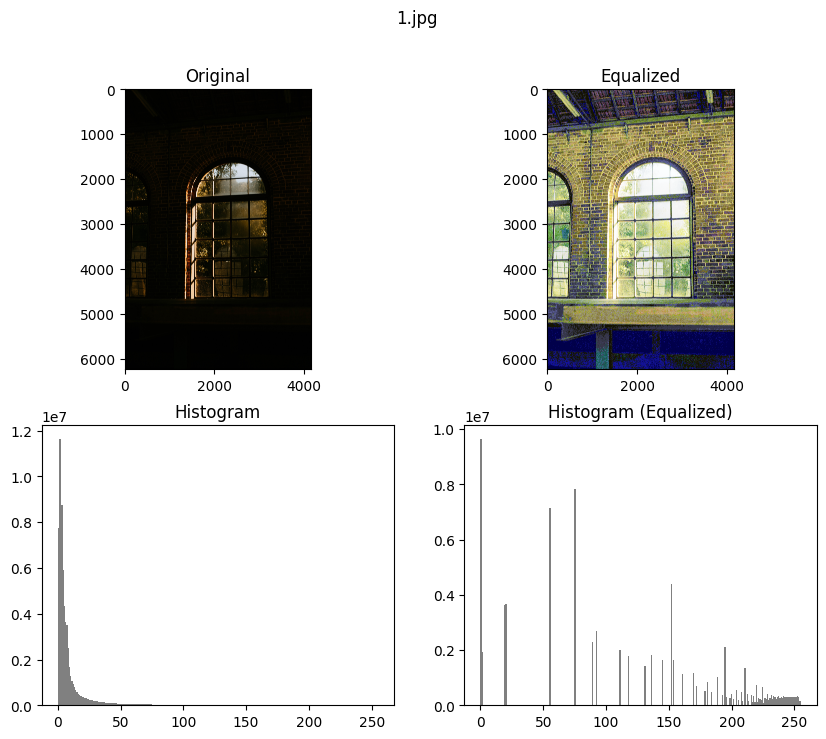

In [7]:
from skimage.metrics import mean_squared_error, peak_signal_noise_ratio, structural_similarity

# Loop over the input images
for filename in os.listdir(input_dir):
    # Load the image
    img = Image.open(os.path.join(input_dir, filename))
    
    # Display the original image and histogram
    fig, axs = plt.subplots(nrows=2, ncols=2, figsize=(10, 8))
    axs[0, 0].imshow(img)
    axs[0, 0].set_title('Original')
    axs[1, 0].hist(np.array(img).flatten(), bins=256, color='gray')
    axs[1, 0].set_title('Histogram')
     
    # Histogram equalization
    eq_r, eq_g, eq_b = img.split()
    eq_r = ImageOps.equalize(eq_r)
    eq_g = ImageOps.equalize(eq_g)
    eq_b = ImageOps.equalize(eq_b)
    eq_img = Image.merge('RGB', (eq_r, eq_g, eq_b))
    eq_filename = os.path.splitext(filename)[0] + '_equalized.jpg'
    eq_img.save(os.path.join(output_dir, eq_filename))
    
    # Display the equalized image and histogram
    axs[0, 1].imshow(eq_img)
    axs[0, 1].set_title('Equalized')
    axs[1, 1].hist(np.array(eq_img).flatten(), bins=256, color='gray')
    axs[1, 1].set_title('Histogram (Equalized)')

    # Save the figure
    fig.suptitle(filename)
    fig.savefig(os.path.join(output_dir, os.path.splitext(filename)[0] + '_histogram.png'))
    

    # Compute evaluation metrics
    # Load the original and processed images using PIL
    orig_img = np.array(img)
    eq_img = np.array(eq_img)

    # Flatten the images to 1D arrays
    orig_flat = orig_img.flatten()
    eq_flat = eq_img.flatten()

    # Calculate the MSE between the original and processed images
    mse_eq = mean_squared_error(orig_flat, eq_flat)
    
    # Calculate the PSNR between the original and processed images
    psnr_eq = peak_signal_noise_ratio(orig_flat, eq_flat)

    # Calculate the SSIM between the original and processed images
    ssim_eq = structural_similarity(orig_img, eq_img, multichannel=True)

    # Append the MSE values to the list
    mse_values.append(mse_eq)
    psnr_values.append(psnr_eq)
    ssim_values.append(ssim_eq)

<ipython-input-8-e02cdcc5aed6>:43: FutureWarning: `multichannel` is a deprecated argument name for `structural_similarity`. It will be removed in version 1.0. Please use `channel_axis` instead.
  ssim_stretched = structural_similarity(orig_img, stretched_img, multichannel=True)


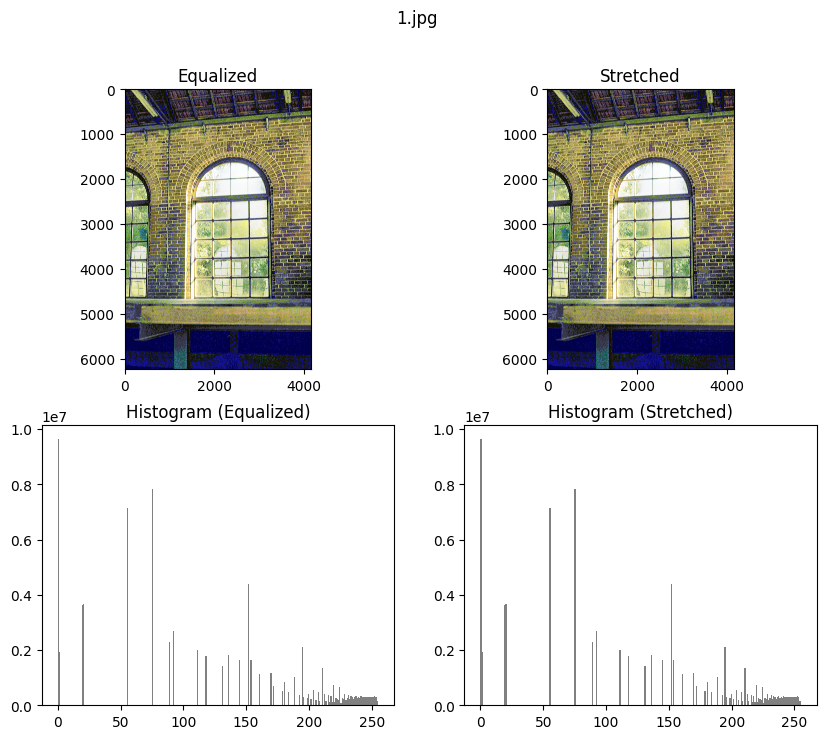

In [8]:
# Loop over the input images
for filename in os.listdir(input_dir):
    # Load the image
    img = Image.open(os.path.join(input_dir, filename))
    
    # Contrast stretching
    stretched_r = ImageOps.autocontrast(eq_r)
    stretched_g = ImageOps.autocontrast(eq_g)
    stretched_b = ImageOps.autocontrast(eq_b)
    stretched_img = Image.merge('RGB', (stretched_r, stretched_g, stretched_b))
    stretched_filename = os.path.splitext(filename)[0] + '_stretched.jpg'
    stretched_img.save(os.path.join(output_dir, stretched_filename))
    
    # Display the stretched image and histogram
    fig, axs = plt.subplots(nrows=2, ncols=2, figsize=(10, 8))
    axs[0, 0].imshow(eq_img)
    axs[0, 0].set_title('Equalized')
    axs[1, 0].hist(np.array(eq_img).flatten(), bins=256, color='gray')
    axs[1, 0].set_title('Histogram (Equalized)')
    axs[0, 1].imshow(stretched_img)
    axs[0, 1].set_title('Stretched')
    axs[1, 1].hist(np.array(stretched_img).flatten(), bins=256, color='gray')
    axs[1, 1].set_title('Histogram (Stretched)')
    
    # Save the figure
    fig.suptitle(filename)
    fig.savefig(os.path.join(output_dir, os.path.splitext(filename)[0] + '_histogram_stretch.png'))
    
    
    # Compute evaluation metrics
    # Load the original and processed images using PIL
    orig_img = np.array(img)
    eq_img = np.array(eq_img)
    stretched_img = np.array(stretched_img)

    # Calculate the MSE between the original and processed images
    mse_stretched = mean_squared_error(orig_img, stretched_img)
    
    # Calculate the PSNR between the original and processed images
    psnr_stretched = peak_signal_noise_ratio(orig_img, stretched_img)

    # Calculate the SSIM between the original and processed images
    ssim_stretched = structural_similarity(orig_img, stretched_img, multichannel=True)

    # Append the MSE values to the list
    mse_values.append(mse_stretched)
    psnr_values.append(psnr_stretched)
    ssim_values.append( ssim_stretched)

# **Point-wise intensity transformations – Log transform**

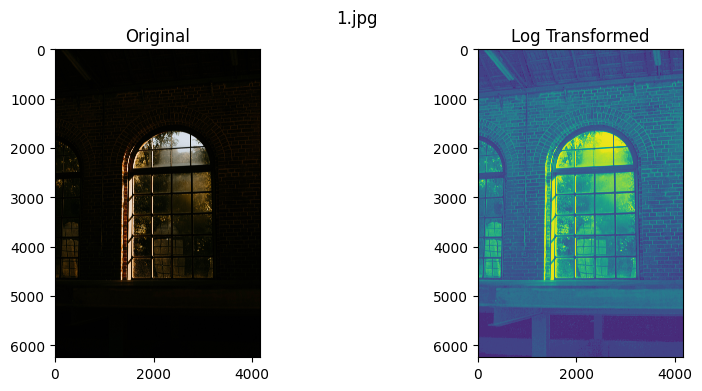

In [9]:
# Loop over the input images
for filename in os.listdir(input_dir):
    # Load the image
    img = Image.open(os.path.join(input_dir, filename))
    
    # Convert the image to grayscale
    img_gray = img.convert('L')
    
    # Display the original image
    fig, axs = plt.subplots(nrows=1, ncols=2, figsize=(10, 4))
    axs[0].imshow(img)
    axs[0].set_title('Original')
     
    # Log transformation
    log_img = ImageOps.autocontrast(img_gray)
    log_img = np.array(log_img)
    log_img = np.log1p(log_img)  # Applying log transformation
    log_img = (log_img / np.max(log_img)) * 255  # Normalize the image
    
    log_img = Image.fromarray(log_img.astype(np.uint8))
    log_filename = os.path.splitext(filename)[0] + '_log.jpg'
    log_img.save(os.path.join(output_dir, log_filename))  # Save the log-transformed image to output_dir
    
    # Display the log-transformed image
    axs[1].imshow(log_img)
    axs[1].set_title('Log Transformed')

    # Save the figure
    fig.suptitle(filename)
    fig.savefig(os.path.join(output_dir, os.path.splitext(filename)[0] + '_log.png'))
    
    # Compute evaluation metrics
    # Convert the images to numpy arrays
    img_array = np.array(img_gray)
    log_img_array = np.array(log_img)

    # Compute the MSE between the original and processed images
    mse_log = mean_squared_error(img_array, log_img_array)
    
    # Calculate the peak signal to noise ratio (PSNR) 
    psnr_log = peak_signal_noise_ratio(img_array, log_img_array)

    # Calculate the structural similarity index (SSIM) 
    ssim_log = structural_similarity(img_array, log_img_array)

    # Append the MSE values to the list
    mse_values.append(mse_log)
    psnr_values.append(psnr_log)
    ssim_values.append(ssim_log)

# **Linear noise smoothing – smoothing with PIL and ImageFilter.BLUR**

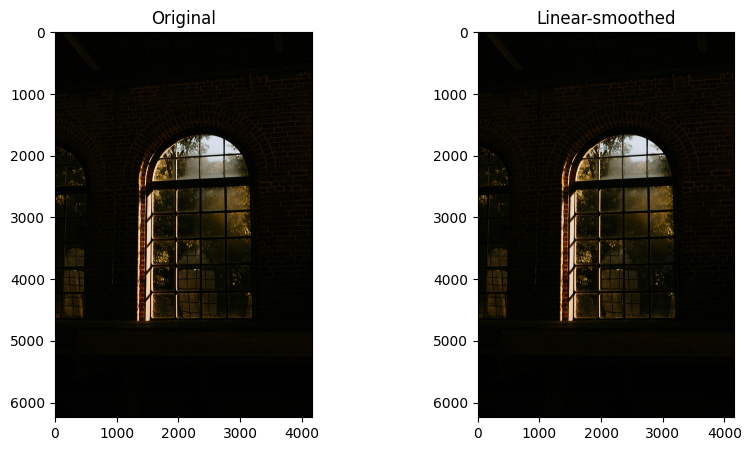

<ipython-input-10-1853c54db880>:39: FutureWarning: `multichannel` is a deprecated argument name for `structural_similarity`. It will be removed in version 1.0. Please use `channel_axis` instead.
  ssim_blur = structural_similarity(orig_img, blur_img, multichannel=False)


In [10]:
# Loop over the input images
for filename in os.listdir(input_dir):
    # Load the image as a NumPy array with a data type of np.float32
    img = np.array(Image.open(os.path.join(input_dir, filename)), dtype=np.float32)
    
    # Scale pixel values to the range [0, 1]
    img = img / 255.0
    
    # Apply Gaussian blur filter with radius 2
    blur_img = Image.fromarray((img * 255).astype(np.uint8)).filter(ImageFilter.GaussianBlur(radius=2))
    
    # Save the processed image to the output directory
    blur_filename = os.path.splitext(filename)[0] + '_blur.jpg'
    blur_img.save(os.path.join(output_dir, blur_filename))  # Save the linear-smoothed image to output_dir
    
    # Visualize the original and linear-smoothed images side by side
    fig, ax = plt.subplots(1, 2, figsize=(10, 5))
    ax[0].imshow(img)
    ax[0].set_title("Original")
    ax[1].imshow(blur_img)
    ax[1].set_title("Linear-smoothed")
    plt.show()
    
    # Load the original and processed images using PIL
    orig_img = Image.open(os.path.join(input_dir, filename)).convert('L')
    blur_img = Image.open(os.path.join(output_dir, blur_filename)).convert('L')
    
    # Convert to numpy arrays
    orig_img = np.array(orig_img)
    blur_img = np.array(blur_img)
    
    # Compute the MSE between the original and processed images
    mse_blur = mean_squared_error(orig_img, blur_img)
    
    # Calculate the peak signal to noise ratio (PSNR) 
    psnr_blur = peak_signal_noise_ratio(orig_img, blur_img)

    # Calculate the structural similarity index (SSIM) 
    ssim_blur = structural_similarity(orig_img, blur_img, multichannel=False)
    
    # Append the evaluation metrics to the lists
    mse_values.append(mse_blur)
    psnr_values.append(psnr_blur)
    ssim_values.append(ssim_blur)

# **Nonlinear noise smoothing – smoothing with PIL and median filter**

<ipython-input-11-41d15509d27e>:14: FutureWarning: `selem` is a deprecated argument name for `median`. It will be removed in version 1.0. Please use `footprint` instead.
  median_img = median(img, selem=selem)


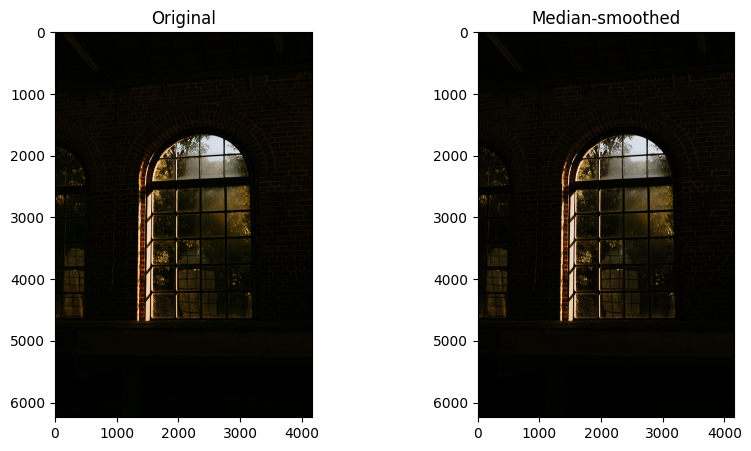

<ipython-input-11-41d15509d27e>:44: FutureWarning: `multichannel` is a deprecated argument name for `structural_similarity`. It will be removed in version 1.0. Please use `channel_axis` instead.
  ssim_median = structural_similarity(orig_img, median_img, multichannel=False)


In [11]:
# Loop over the input images
for filename in os.listdir(input_dir):
    # Load the image as a NumPy array with a data type of np.float32
    img = np.array(Image.open(os.path.join(input_dir, filename)), dtype=np.float32)
    
    # Scale pixel values to the range [0, 1]
    img = img / 255.0
    
    # Apply median filter with a kernel size of 3
    if len(img.shape) == 2:  # Grayscale image
        selem = np.ones((3, 3))
    elif len(img.shape) == 3:  # Color image
        selem = np.ones((3, 3, 3))
    median_img = median(img, selem=selem)
    median_img = Image.fromarray((median_img * 255).astype(np.uint8))
    
    # Save the processed image to the output directory
    median_filename = os.path.splitext(filename)[0] + '_median.jpg'
    median_img.save(os.path.join(output_dir, median_filename))
    
    # Visualize the original and median-smoothed images side by side
    fig, ax = plt.subplots(1, 2, figsize=(10, 5))
    ax[0].imshow(img)
    ax[0].set_title("Original")
    ax[1].imshow(median_img)
    ax[1].set_title("Median-smoothed")
    plt.show()

    # Load the original and processed images using PIL
    orig_img = Image.open(os.path.join(input_dir, filename)).convert('L')
    median_img = Image.open(os.path.join(output_dir, median_filename)).convert('L')
    
    # Convert to numpy arrays
    orig_img = np.array(orig_img)
    median_img = np.array(median_img)
    
    # Compute the MSE between the original and processed images
    mse_median = mean_squared_error(orig_img, median_img)
    
    # Calculate the peak signal to noise ratio (PSNR) 
    psnr_median = peak_signal_noise_ratio(orig_img, median_img)

    # Calculate the structural similarity index (SSIM) 
    ssim_median = structural_similarity(orig_img, median_img, multichannel=False)
    
    # Append the evaluation metrics to the lists
    mse_values.append(mse_median)
    psnr_values.append(psnr_median)
    ssim_values.append(ssim_median)


# **Image derivatives – Gradient**

<ipython-input-12-3634015c2ace>:34: FutureWarning: `multichannel` is a deprecated argument name for `structural_similarity`. It will be removed in version 1.0. Please use `channel_axis` instead.
  ssim_grad = structural_similarity(orig_img, grad_img, multichannel=True)


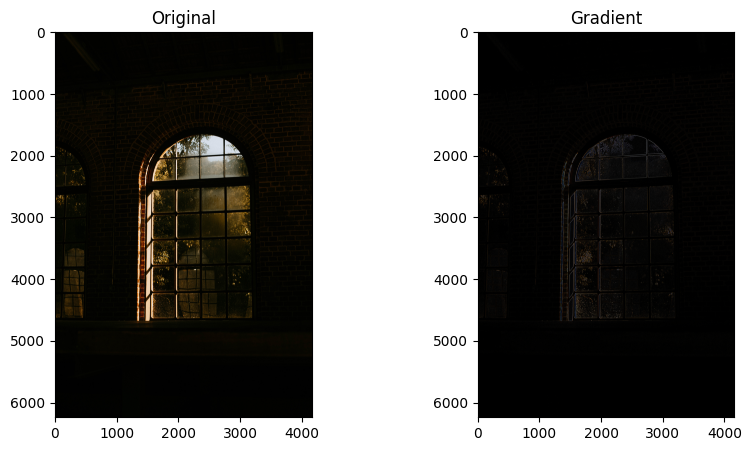

In [12]:
# Loop over the input images
for filename in os.listdir(input_dir):
    # Load the image as a NumPy array with a data type of np.float32
    img = np.array(Image.open(os.path.join(input_dir, filename)), dtype=np.float32)
    
    # Scale pixel values to the range [0, 1]
    img = img / 255.0
    
    # Compute the gradient magnitude of the image
    grad_mag = cv2.magnitude(cv2.Sobel(img, cv2.CV_32F, 1, 0), cv2.Sobel(img, cv2.CV_32F, 0, 1))

    # Normalize the gradient values to the range [0, 1]
    grad_mag_norm = cv2.normalize(grad_mag, None, 0, 1, cv2.NORM_MINMAX, cv2.CV_32F)

    # Convert the normalized values to 8-bit unsigned integers for saving as an image
    grad_mag_uint8 = (grad_mag_norm * 255).astype(np.uint8)

    # Save the gradient image to the output directory
    grad_filename = os.path.splitext(filename)[0] + '_grad.jpg'
    cv2.imwrite(os.path.join(output_dir, grad_filename), grad_mag_uint8)
    
    # Compute evaluation metrics
    # Load the original and processed images using PIL
    orig_img = np.array(Image.open(os.path.join(input_dir, filename))) / 255.0
    grad_img = np.array(Image.open(os.path.join(output_dir, grad_filename))) / 255.0

    # Compute the MSE between the original and processed images
    mse_grad = mean_squared_error(orig_img.reshape(-1), grad_img.reshape(-1))
    
    # Calculate the peak signal to noise ratio (PSNR) 
    psnr_grad = peak_signal_noise_ratio(orig_img, grad_img)

    # Calculate the structural similarity index (SSIM) 
    ssim_grad = structural_similarity(orig_img, grad_img, multichannel=True)

    # Append the evaluation metrics to the lists
    mse_values.append(mse_grad)
    psnr_values.append(psnr_grad)
    ssim_values.append(ssim_grad)

    # Visualize the original and gradient images side by side
    fig, ax = plt.subplots(1, 2, figsize=(10, 5))
    ax[0].imshow(orig_img)
    ax[0].set_title("Original")
    ax[1].imshow(grad_mag_norm, cmap='gray')
    ax[1].set_title("Gradient")
    plt.show()


# **Sharpening and unsharp masking**

<ipython-input-13-88106d142ceb>:26: UserWarning: Inputs have mismatched dtype.  Setting data_range based on image_true.
  psnr_sharpened = peak_signal_noise_ratio(orig_img, sharpened)
<ipython-input-13-88106d142ceb>:29: FutureWarning: `multichannel` is a deprecated argument name for `structural_similarity`. It will be removed in version 1.0. Please use `channel_axis` instead.
  ssim_sharpened = structural_similarity(orig_img, sharpened, multichannel=True)
/usr/local/lib/python3.10/dist-packages/skimage/_shared/utils.py:348: UserWarning: Inputs have mismatched dtype.  Setting data_range based on im1.dtype.
  return func(*args, **kwargs)


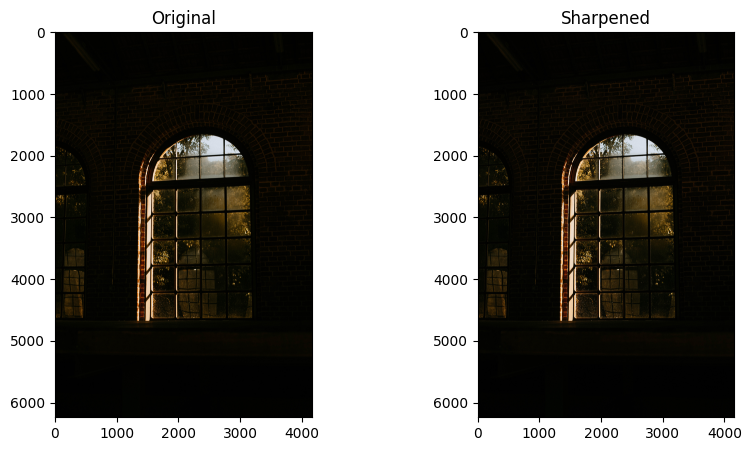

In [13]:
# Define the sharpening kernel
sharpen_kernel = np.array([[0, -1, 0], [-1, 5, -1], [0, -1, 0]])

# Loop over the input images
for filename in os.listdir(input_dir):
    # Load the image using PIL and convert it to a NumPy array with a data type of np.float32
    img = np.array(Image.open(os.path.join(input_dir, filename)).convert('RGB'), dtype=np.float32)
    
    # Scale pixel values to the range [0, 1]
    img = img / 255.0
    
    # Apply the sharpening kernel to the image
    sharpened = Image.fromarray(np.uint8(img*255)).filter(ImageFilter.Kernel((3,3), sharpen_kernel.flatten()))

    # Convert the sharpened image to a NumPy array with a data type of np.float32
    sharpened = np.array(sharpened, dtype=np.float32) / 255.0

    # Compute evaluation metrics
    # Load the original image using PIL
    orig_img = np.array(Image.open(os.path.join(input_dir, filename)).convert('RGB')) / 255.0

    # Compute the MSE between the original and sharpened images
    mse_sharpened = mean_squared_error(orig_img, sharpened)
    
    # Calculate the peak signal to noise ratio (PSNR) 
    psnr_sharpened = peak_signal_noise_ratio(orig_img, sharpened)

    # Calculate the structural similarity index (SSIM) 
    ssim_sharpened = structural_similarity(orig_img, sharpened, multichannel=True)

    # Append the evaluation metrics to the lists
    mse_values.append(mse_sharpened)
    psnr_values.append(psnr_sharpened)
    ssim_values.append(ssim_sharpened)

    # Convert the sharpened array to 8-bit unsigned integers for saving as an image
    sharpened_uint8 = (sharpened * 255).astype(np.uint8)

    # Save the sharpened image
    sharpened_filename = os.path.splitext(filename)[0] + '_sharpened.jpg'
    Image.fromarray(sharpened_uint8).save(os.path.join(output_dir, sharpened_filename))
    
    # Visualize the original and sharpened images side by side
    fig, ax = plt.subplots(1, 2, figsize=(10, 5))
    ax[0].imshow(orig_img)
    ax[0].set_title("Original")
    ax[1].imshow(sharpened)
    ax[1].set_title("Sharpened")
    plt.show()


<ipython-input-14-8faa32dca781>:32: UserWarning: Inputs have mismatched dtype.  Setting data_range based on image_true.
  psnr_unsharped = peak_signal_noise_ratio(orig_img, unsharped)
<ipython-input-14-8faa32dca781>:35: FutureWarning: `multichannel` is a deprecated argument name for `structural_similarity`. It will be removed in version 1.0. Please use `channel_axis` instead.
  ssim_unsharped = structural_similarity(orig_img, unsharped, multichannel=True)


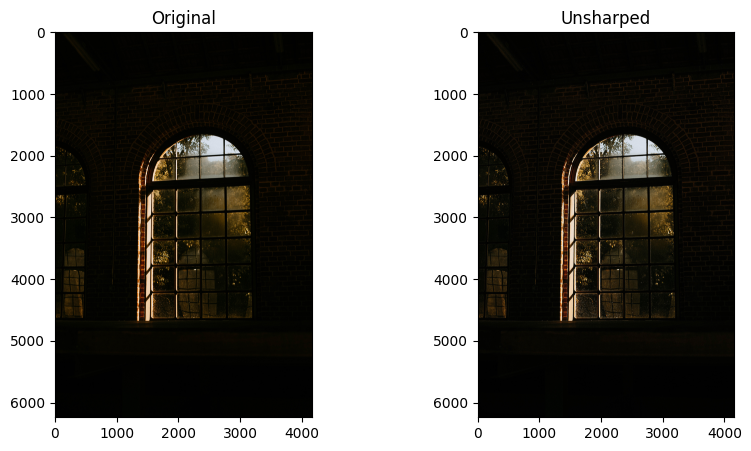

In [14]:
from PIL import Image, ImageFilter
import os
import numpy as np
from skimage.metrics import mean_squared_error, peak_signal_noise_ratio, structural_similarity
import matplotlib.pyplot as plt

# Define the unsharp masking kernel
unsharp_kernel = np.array([[-1, -1, -1], [-1, 9, -1], [-1, -1, -1]])

# Loop over the input images
for filename in os.listdir(input_dir):
    # Load the image using PIL and convert it to a NumPy array with a data type of np.float32
    img = np.array(Image.open(os.path.join(input_dir, filename)).convert('RGB'), dtype=np.float32)
    
    # Scale pixel values to the range [0, 1]
    img = img / 255.0
    
    # Apply the unsharp masking kernel to the image
    unsharped = Image.fromarray(np.uint8(img*255)).filter(ImageFilter.Kernel((3,3), unsharp_kernel.flatten()))

    # Convert the unsharped image to a NumPy array with a data type of np.float32
    unsharped = np.array(unsharped, dtype=np.float32) / 255.0

    # Compute evaluation metrics
    # Load the original image using PIL
    orig_img = np.array(Image.open(os.path.join(input_dir, filename)).convert('RGB')) / 255.0

    # Compute the MSE between the original and unsharped images
    mse_unsharped = mean_squared_error(orig_img, unsharped)
    
    # Calculate the peak signal to noise ratio (PSNR) 
    psnr_unsharped = peak_signal_noise_ratio(orig_img, unsharped)

    # Calculate the structural similarity index (SSIM) 
    ssim_unsharped = structural_similarity(orig_img, unsharped, multichannel=True)

    # Append the evaluation metrics to the lists
    mse_values.append(mse_unsharped)
    psnr_values.append(psnr_unsharped)
    ssim_values.append(ssim_unsharped)

    # Convert the unsharped array to 8-bit unsigned integers for saving as an image
    unsharped_uint8 = (unsharped * 255).astype(np.uint8)

    # Save the unsharped image
    unsharped_filename = os.path.splitext(filename)[0] + '_unsharped.jpg'
    Image.fromarray(unsharped_uint8).save(os.path.join(output_dir, unsharped_filename))
    
    # Visualize the original and unsharped images side by side
    fig, ax = plt.subplots(1, 2, figsize=(10, 5))
    ax[0].imshow(orig_img)
    ax[0].set_title("Original")
    ax[1].imshow(unsharped)
    ax[1].set_title("Unsharped")
    plt.show()


In [15]:
!pip install keras_preprocessing

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [16]:
!pip install huggingface_hub

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [17]:
from huggingface_hub import from_pretrained_keras # download the model
import keras # deep learning
from PIL import Image # Image processing
from keras_preprocessing.image import img_to_array

In [18]:
model = from_pretrained_keras("keras-io/lowlight-enhance-mirnet", compile=False)

config.json not found in HuggingFace Hub.


Fetching 11 files:   0%|          | 0/11 [00:00<?, ?it/s]

In [19]:
low_light_img = Image.open("/content/1.jpg").convert('RGB')

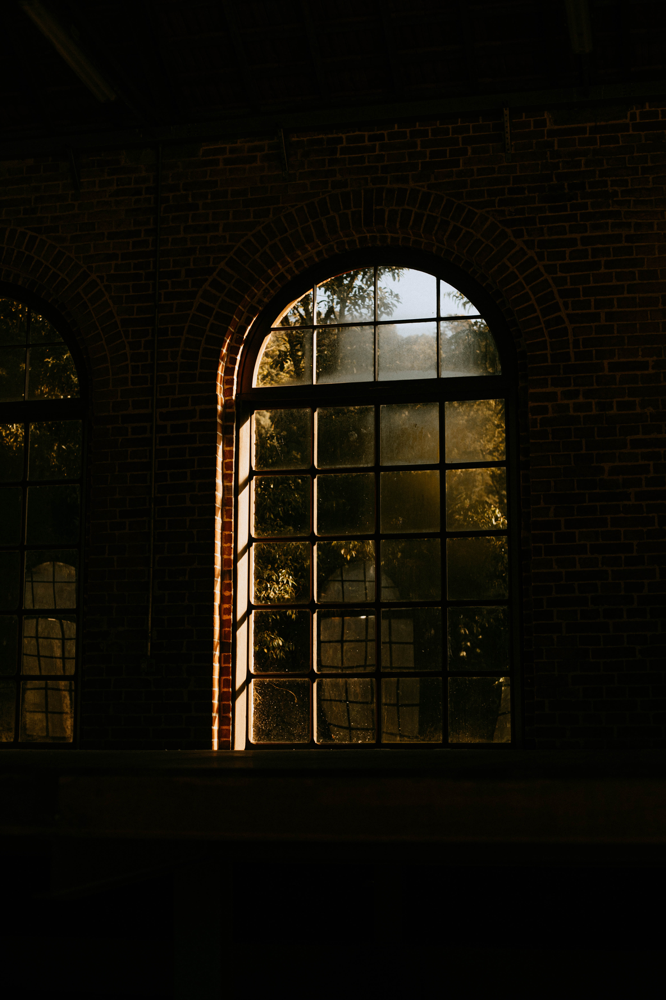

In [20]:
low_light_img

In [21]:
low_light_img = low_light_img.resize((256,256),Image.NEAREST)

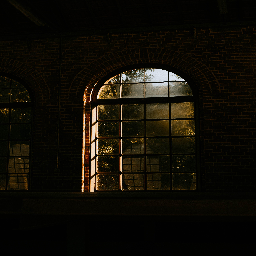

In [22]:
low_light_img

In [23]:
# Convert the image to a NumPy array
image = img_to_array(low_light_img)

In [24]:
image.shape

(256, 256, 3)

In [25]:
image = image.astype('float32') / 255.0

In [26]:
image.shape

(256, 256, 3)

In [27]:
image = np.expand_dims(image, axis = 0)

In [28]:
image.shape

(1, 256, 256, 3)

In [29]:
output = model.predict(image) # model inference to enhance the low light pics

1/1 [==============================] - 27s 27s/step


In [30]:
output_image = output[0] * 255.0

In [31]:
output_image.shape

(256, 256, 3)

In [32]:
output_image = output_image.clip(0,255)

In [33]:
output_image.shape

(256, 256, 3)

In [34]:
output_image = output_image.reshape((np.shape(output_image)[0],np.shape(output_image)[1],3))

In [35]:
output_image

array([[[47.757412, 48.17788 , 39.463253],
        [56.881477, 58.735405, 50.889675],
        [55.503223, 67.39475 , 52.6907  ],
        ...,
        [65.62063 , 67.46159 , 57.889038],
        [59.698242, 59.762947, 46.88327 ],
        [45.180332, 45.67534 , 41.381866]],

       [[54.58505 , 54.761738, 51.900204],
        [72.97927 , 64.52029 , 55.802296],
        [67.630974, 71.17225 , 48.733013],
        ...,
        [68.82331 , 69.47511 , 53.423687],
        [70.72157 , 68.24711 , 50.059155],
        [61.15138 , 55.901573, 46.843163]],

       [[58.709023, 56.616566, 53.928043],
        [76.981735, 67.09222 , 53.605244],
        [70.3952  , 71.069115, 47.147564],
        ...,
        [67.73884 , 64.17575 , 49.921337],
        [68.84996 , 62.698303, 50.7     ],
        [63.294594, 60.629658, 49.310844]],

       ...,

       [[49.06098 , 50.066498, 42.45454 ],
        [63.076176, 53.49446 , 42.370476],
        [52.2094  , 49.050915, 34.08269 ],
        ...,
        [64.705086, 53.963

In [36]:
output_image = np.uint32(output_image)

In [37]:
output_image

array([[[47, 48, 39],
        [56, 58, 50],
        [55, 67, 52],
        ...,
        [65, 67, 57],
        [59, 59, 46],
        [45, 45, 41]],

       [[54, 54, 51],
        [72, 64, 55],
        [67, 71, 48],
        ...,
        [68, 69, 53],
        [70, 68, 50],
        [61, 55, 46]],

       [[58, 56, 53],
        [76, 67, 53],
        [70, 71, 47],
        ...,
        [67, 64, 49],
        [68, 62, 50],
        [63, 60, 49]],

       ...,

       [[49, 50, 42],
        [63, 53, 42],
        [52, 49, 34],
        ...,
        [64, 53, 44],
        [64, 56, 48],
        [61, 53, 48]],

       [[48, 47, 43],
        [69, 57, 46],
        [61, 55, 42],
        ...,
        [70, 57, 50],
        [66, 58, 57],
        [56, 54, 50]],

       [[39, 34, 36],
        [56, 48, 40],
        [57, 46, 37],
        ...,
        [61, 52, 43],
        [53, 50, 47],
        [45, 44, 32]]], dtype=uint32)

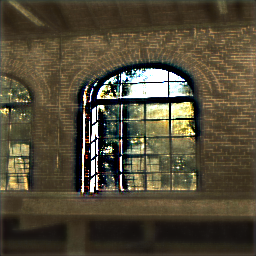

In [38]:
Image.fromarray(output_image.astype('uint8'),'RGB')

In [39]:
from skimage import metrics

# Calculate PSNR
psnr = metrics.peak_signal_noise_ratio(image[0], output_image)

# Calculate MSE
mse = np.mean((image[0] - output_image) ** 2)

# Calculate SSIM
ssim = metrics.structural_similarity(image[0], output_image, multichannel=True)

print("PSNR:", psnr)
print("MSE:", mse)
print("SSIM:", ssim)

PSNR: -38.94414508143931
MSE: 7841.777365170518
SSIM: 3.5705332e-05


<ipython-input-39-040d325a59a1>:4: UserWarning: Inputs have mismatched dtype.  Setting data_range based on image_true.
  psnr = metrics.peak_signal_noise_ratio(image[0], output_image)
<ipython-input-39-040d325a59a1>:10: FutureWarning: `multichannel` is a deprecated argument name for `structural_similarity`. It will be removed in version 1.0. Please use `channel_axis` instead.
  ssim = metrics.structural_similarity(image[0], output_image, multichannel=True)
/usr/local/lib/python3.10/dist-packages/skimage/_shared/utils.py:348: UserWarning: Inputs have mismatched dtype.  Setting data_range based on im1.dtype.
  return func(*args, **kwargs)


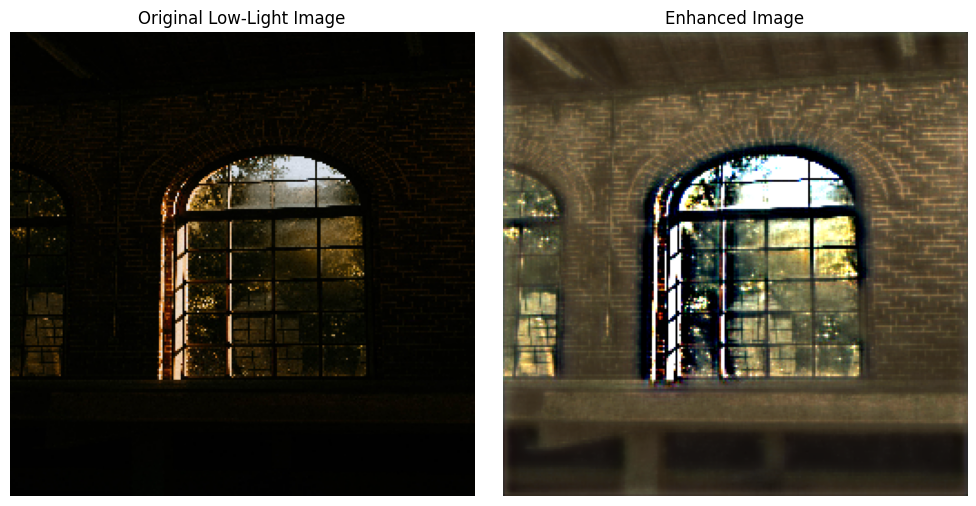

PSNR: -38.94414508143931
MSE: 7841.777365170518
SSIM: 3.5705332e-05


In [40]:
# Visualize the images
fig, axes = plt.subplots(1, 2, figsize=(10, 5))
axes[0].imshow(low_light_img)
axes[0].set_title("Original Low-Light Image")
axes[0].axis("off")
axes[1].imshow(output_image)
axes[1].set_title("Enhanced Image")
axes[1].axis("off")
plt.tight_layout()
plt.show()

print("PSNR:", psnr)
print("MSE:", mse)
print("SSIM:", ssim)

In [ ]:
# Print the summary of the MIRNet model
model.summary()

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, None, None,  0           []                               
                                 3)]                                                              
                                                                                                  
 conv2d (Conv2D)                (None, None, None,   1792        ['input_1[0][0]']                
                                64)                                                               
                                                                                                  
 conv2d_1 (Conv2D)              (None, None, None,   36928       ['conv2d[0][0]']                 
                                64)                                                           

In [41]:
# Append the evaluation metrics to the lists
mse_values.append(mse)
psnr_values.append(psnr)
ssim_values.append(ssim)

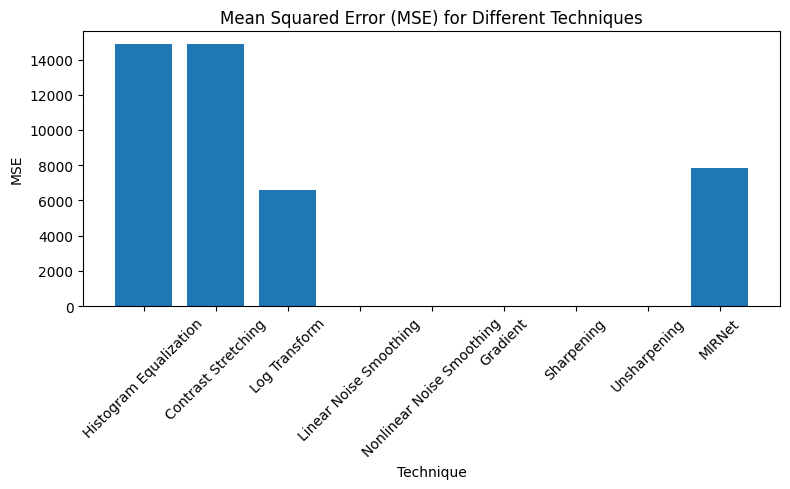

In [46]:
import matplotlib.pyplot as plt

# Define the list of techniques
techniques = ['Histogram Equalization', 'Contrast Stretching', 'Log Transform', 'Linear Noise Smoothing',
              'Nonlinear Noise Smoothing', 'Gradient', 'Sharpening', 'Unsharpening', 'MIRNet']

# Plot the Mean Squared Error (MSE)
plt.figure(figsize=(8, 5))
plt.bar(techniques, mse_values)
plt.xlabel('Technique')
plt.ylabel('MSE')
plt.title('Mean Squared Error (MSE) for Different Techniques')
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()



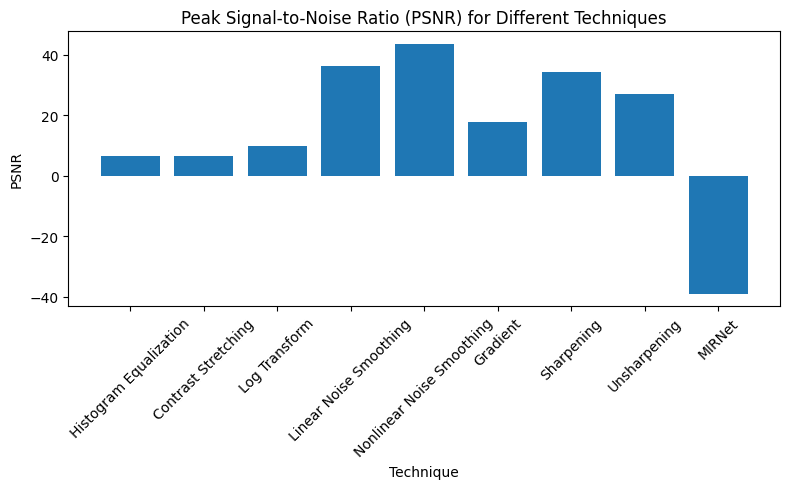

In [45]:
# Plot the Peak Signal-to-Noise Ratio (PSNR)
plt.figure(figsize=(8, 5))
plt.bar(techniques, psnr_values)
plt.xlabel('Technique')
plt.ylabel('PSNR')
plt.title('Peak Signal-to-Noise Ratio (PSNR) for Different Techniques')
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

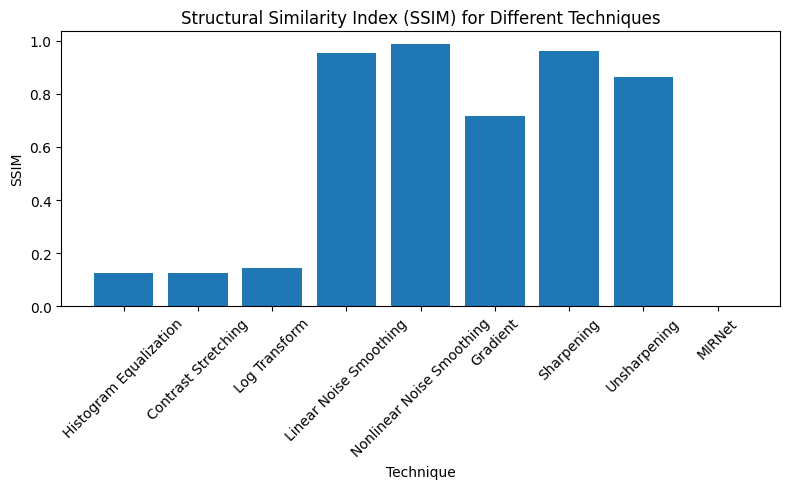

In [47]:
# Plot the Structural Similarity Index (SSIM)
plt.figure(figsize=(8, 5))
plt.bar(techniques, ssim_values)
plt.xlabel('Technique')
plt.ylabel('SSIM')
plt.title('Structural Similarity Index (SSIM) for Different Techniques')
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()